<a href="https://colab.research.google.com/github/ccwu0918/yolov7-colab/blob/main/Traffic_Tracking.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# YOLOv4物件辨識演算法，使用Colab
本課程將介紹Darknet為框架所建立的YOLOv4演算法，並會使用照片或即時影像進行分析

步驟1：連結到自己的雲端硬碟，後續可以直接啟用辨識

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


步驟2：將路徑移動到自己的雲端硬碟

In [ ]:
import os
if os.path.exists('/content/drive/MyDrive/Colab Notebooks'):
  %cd "/content/drive/MyDrive/Colab Notebooks"
%ls -al

步驟3：載入相依性套件

In [4]:
# import dependencies
from IPython.display import display, Javascript, HTML, Image, clear_output
from google.colab.output import eval_js
from google.colab.patches import cv2_imshow
from base64 import b64decode, b64encode
import cv2
import numpy as np
import PIL
import io
import html
import time
import matplotlib.pyplot as plt
%matplotlib inline

## Darknet神經網路建立
我們使用的Darknet為Alex版本的Darknet網路框架

步驟4：將計畫檔複製到我們的雲端硬碟

In [6]:
# clone darknet repo
if not os.path.exists('darknet'):
  !git clone https://github.com/AlexeyAB/darknet

步驟5：修改編譯設定，主要是因為Colab雲端電腦有提供高效能GPU，所以我們使用Nvidia所提供的Cuda平行運算架構來建立Darknet。

In [7]:
# change makefile to have GPU, OPENCV and LIBSO enabled
if os.path.exists('darknet'):
  %cd darknet
  !sed -i 's/OPENCV=0/OPENCV=1/' Makefile
  !sed -i 's/GPU=0/GPU=1/' Makefile
  !sed -i 's/CUDNN=0/CUDNN=1/' Makefile
  !sed -i 's/CUDNN_HALF=0/CUDNN_HALF=1/' Makefile
  !sed -i 's/LIBSO=0/LIBSO=1/' Makefile

/content/drive/MyDrive/Colab Notebooks/darknet


步驟6：編譯Darknet（需要1-3分鐘左右）

In [8]:
# make darknet (builds darknet so that you can then use the darknet.py file and have its dependencies)
if not os.path.exists("libcudnn_so"):
  !make

步驟7：下載YOLOv4 Pre-Train類神經網路模型的權重檔，本模型能辨識日常生活中的80個物件，相關資料都在cfg/coco.names中

YOLOv4：全模型，有162層CNN所建立的類神經網路，正確率較高

YOLOv4-tiny：精簡模型，只有38層，效率高，但辨識率不佳

In [9]:
if not os.path.exists("yolov4-tiny.weights"):
  !wget https://github.com/AlexeyAB/darknet/releases/download/darknet_yolo_v4_pre/yolov4-tiny.weights
if not os.path.exists("yolov4.weights"):  
  !wget https://github.com/AlexeyAB/darknet/releases/download/darknet_yolo_v3_optimal/yolov4.weights

## Darknet for Python
步驟8：載入Darknet

這部份為使用Darknet所需要的一些功能，其中第2行所載入的路徑，必須要注意
包含三個設定：cfg網路設定檔，data能辨識的物件名稱，weights類神經網路權重檔

In [10]:
# %cd darknet

In [11]:
!whereis libcudnn.so.
!ls /usr/lib/x86_64-linux-gnu/libcudnn.so -al
!ls /usr/lib/x86_64-linux-gnu/libcudnn.so.8 -al

libcudnn.so: /usr/lib/x86_64-linux-gnu/libcudnn.so /usr/lib/x86_64-linux-gnu/libcudnn.so.8
lrwxrwxrwx 1 root root 29 Oct 28 03:19 /usr/lib/x86_64-linux-gnu/libcudnn.so -> /etc/alternatives/libcudnn_so
lrwxrwxrwx 1 root root 17 Feb 25  2021 /usr/lib/x86_64-linux-gnu/libcudnn.so.8 -> libcudnn.so.8.1.1


In [ ]:
#!cp /etc/alternatives/libcudnn_so .
#!cp /usr/lib/x86_64-linux-gnu/libcudnn.so.8.1.1 .

In [ ]:
# !cp /content/drive/MyDrive/Colab\ Notebooks/darknet/libcudnn_so /etc/alternatives/libcudnn_so
# !cp /content/drive/MyDrive/Colab\ Notebooks/darknet/libcudnn.so.8.1.1 /usr/lib/x86_64-linux-gnu/libcudnn.so.8.1.1 

In [ ]:
# !ln -s /etc/alternatives/libcudnn_so /usr/lib/x86_64-linux-gnu/libcudnn.so
# !ln -s /usr/lib/x86_64-linux-gnu/libcudnn.so.8.1.1 /usr/lib/x86_64-linux-gnu/libcudnn.so.8

In [12]:
from darknet import *
network, class_names, class_colors = load_network("cfg/yolov4.cfg", "cfg/coco.data", "yolov4.weights")
width = network_width(network)
height = network_height(network)

# darknet helper function to run detection on image
def darknet_helper(img, width, height):
  darknet_image = make_image(width, height, 3)
  img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  img_resized = cv2.resize(img_rgb, (width, height),
                              interpolation=cv2.INTER_LINEAR)

  # get image ratios to convert bounding boxes to proper size
  img_height, img_width, _ = img.shape
  width_ratio = img_width/width
  height_ratio = img_height/height

  # run model on darknet style image to get detections
  copy_image_from_bytes(darknet_image, img_resized.tobytes())
  detections = detect_image(network, class_names, darknet_image)
  free_image(darknet_image)
  return detections, width_ratio, height_ratio

## 測試
步驟9：先使用內建的照片進行測試，內建的照片都放在data中，可以用雲端硬碟來事先查看

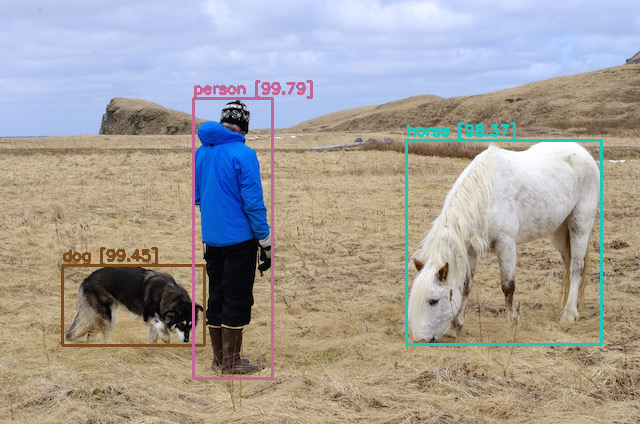

In [ ]:
image = cv2.imread("data/person.jpg")
detections, width_ratio, height_ratio = darknet_helper(image, width, height)

for label, confidence, bbox in detections:
  left, top, right, bottom = bbox2points(bbox) #比例
  left, top, right, bottom = int(left * width_ratio), int(top * height_ratio), int(right * width_ratio), int(bottom * height_ratio) #像素座標
  cv2.rectangle(image, (left, top), (right, bottom), class_colors[label], 2) #繪出方形(bbox)
  #      照片    文字內容                     位置         字形          大小   顏色      寬度
  cv2.putText(image, "{} [{:.2f}]".format(label, float(confidence)),(left, top - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5,class_colors[label], 2)

cv2_imshow(image)

步驟10：上傳一張照片測試看看

從網路上，搜尋一張照片，例如「路口」，下載後重新命名為「test.jpg」，上傳到darknet/data底下，並執行看看

步驟11：思考一下，如何修改程式碼，可以計算出畫面中的人數？


In [14]:
if not os.path.exists("test.jpg"):
  !wget https://www.upmedia.mg/upload/article/20200904161256111093.JPG
  !mv 20200904161256111093.JPG test.jpg

--2022-12-26 20:52:38--  https://www.upmedia.mg/upload/article/20200904161256111093.JPG
Resolving www.upmedia.mg (www.upmedia.mg)... 192.124.249.65
Connecting to www.upmedia.mg (www.upmedia.mg)|192.124.249.65|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 462148 (451K) [image/jpeg]
Saving to: ‘20200904161256111093.JPG’

2020090416125611109 100%[===================>] 451.32K   770KB/s    in 0.6s    

2022-12-26 20:52:39 (770 KB/s) - ‘20200904161256111093.JPG’ saved [462148/462148]



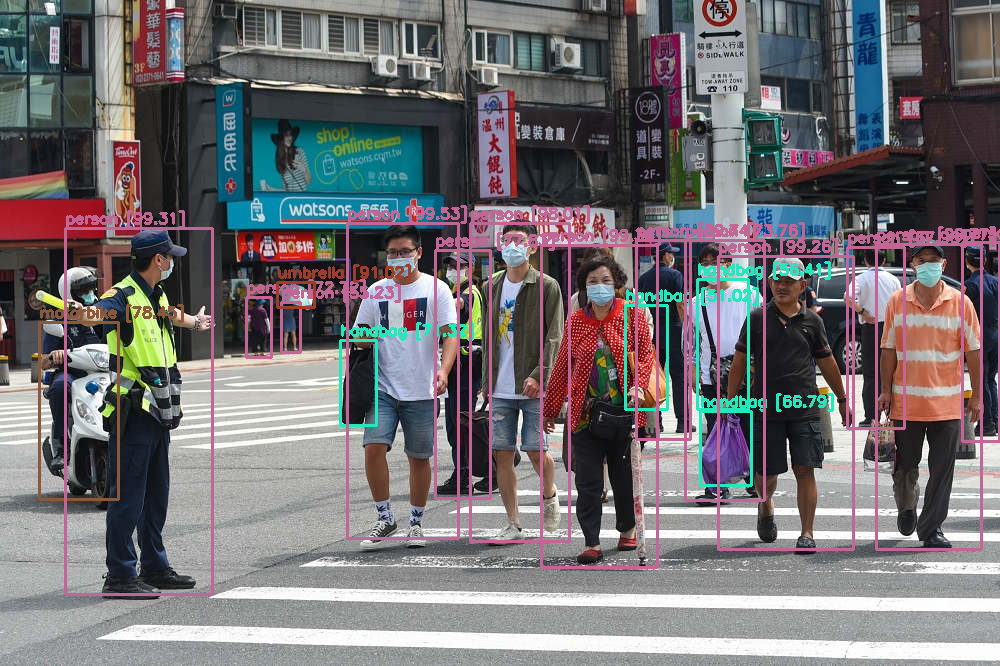

In [ ]:
#https://www.upmedia.mg/upload/article/20200904161256111093.JPG
image = cv2.imread("test.jpg")
detections, width_ratio, height_ratio = darknet_helper(image, width, height)
for label, confidence, bbox in detections:
  left, top, right, bottom = bbox2points(bbox) #比例
  left, top, right, bottom = int(left * width_ratio), int(top * height_ratio), int(right * width_ratio), int(bottom * height_ratio) #像素座標
  cv2.rectangle(image, (left, top), (right, bottom), class_colors[label], 2) #繪出方形(bbox)
  #      照片    文字內容                     位置         字形          大小   顏色      寬度
  cv2.putText(image, "{} [{:.2f}]".format(label, float(confidence)),(left, top - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5,class_colors[label], 2)
cv2_imshow(image)

圖片中handbag的數量有4
圖片中person的數量有13
圖片中motorbike的數量有1
圖片中umbrella的數量有1


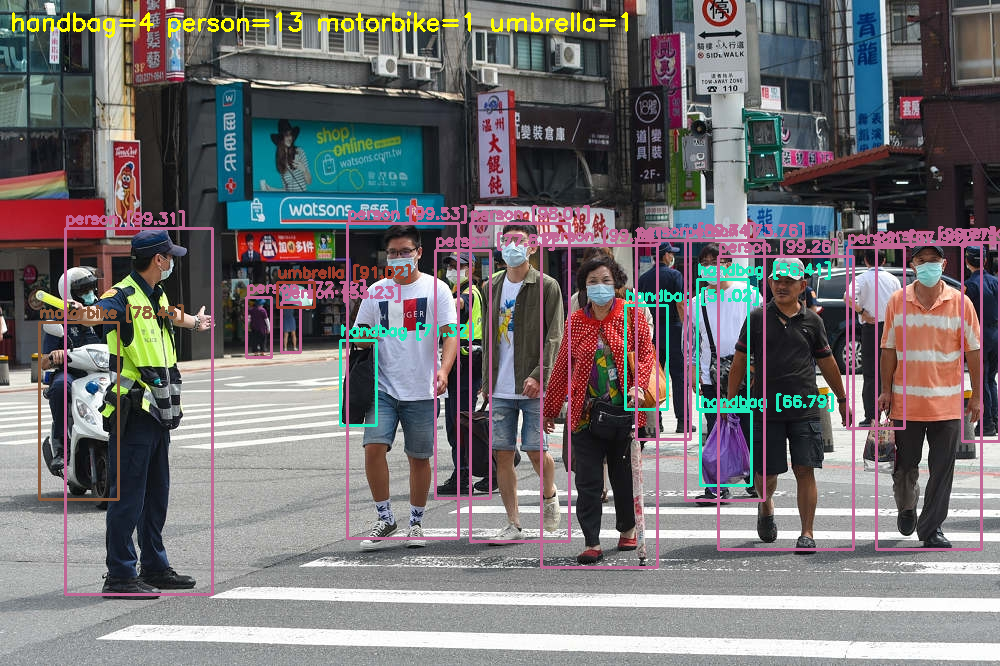

In [ ]:
#https://www.upmedia.mg/upload/article/20200904161256111093.JPG
image = cv2.imread("test.jpg")
detections, width_ratio, height_ratio = darknet_helper(image, width, height)
objs={}
for label, confidence, bbox in detections:
  left, top, right, bottom = bbox2points(bbox) #比例
  left, top, right, bottom = int(left * width_ratio), int(top * height_ratio), int(right * width_ratio), int(bottom * height_ratio) #像素座標
  cv2.rectangle(image, (left, top), (right, bottom), class_colors[label], 2) #繪出方形(bbox)
  #      照片    文字內容                     位置         字形          大小   顏色      寬度
  cv2.putText(image, "{} [{:.2f}]".format(label, float(confidence)),(left, top - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5,class_colors[label], 2)
  if label in objs:
    objs[label]+=1
  else:
    objs[label]=1
obj_str = ""
for obj_ in objs:
  obj_str += obj_ + ("=" + str(objs[obj_]) + " ")
  print(f'圖片中{obj_}的數量有{objs[obj_]}')
cv2.putText(image, obj_str,(10, 30), cv2.FONT_HERSHEY_SIMPLEX, 0.8,(0,255,255), 2)
cv2_imshow(image)

In [15]:
if not os.path.exists('City.mp4'):
  !gdown --fuzzy '1F27kKFkuKdwUDnc832pCLD7Ovi7mvhs_'
# !unzip -q mask-detection.zip
# !rm mask-detection.zip
# !rm "/content/drive/MyDrive/Colab Notebooks/yolov7/__MACOSX" -Rf

In [18]:
#t.ly/5k0K
import darknet
import time
import cv2
import numpy as np
#車流辨識用
objIndex=0
ObjList=[] #(index, px, py)


TARGET= 'City.mp4'
WEIGHT="yolov4.weights"
CFG="./cfg/yolov4.cfg"
DATA="./cfg/coco.data"
CONFTH=0.5
(WIDTH,HEIGHT)=(1280,720)
network, class_names, class_colors = darknet.load_network(
    CFG,
    DATA,
    WEIGHT,
    batch_size=1
)

#YOLO物件辨識主程式
def image_detection(image, network, class_names, class_colors, thresh):

    darknet_image = darknet.make_image(WIDTH, HEIGHT, 3)  
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    image_resized = cv2.resize(image_rgb, (WIDTH, HEIGHT),
                               interpolation=cv2.INTER_LINEAR)

    darknet.copy_image_from_bytes(darknet_image, image_resized.tobytes())
    detections = darknet.detect_image(network, class_names, darknet_image, thresh=thresh)
    darknet.free_image(darknet_image)
    image = darknet.draw_boxes(detections, image_resized, class_colors)
    return cv2.cvtColor(image, cv2.COLOR_BGR2RGB), detections

#物件追蹤程式
def TrackObj(newCenterList,ObjList1,objIndex):
    ObjListTemp=[]
    try:
        for i in range(len(newCenterList)):
            newP=(newCenterList[i][0],newCenterList[i][1])
            Obj,objIndex = MatchObj(newP,ObjList1,objIndex)
            ObjListTemp.append(Obj)
        return ObjListTemp,objIndex
    except Exception as err:
        print(err)
        return None,objIndex

#位置比對程式
def MatchObj(newP,ObjList1,ObjIndex):
    dtlist=[]
    dtIndex=[]
    #計算物件與所有前一畫面物件的距離
    for i in range(len(ObjList1)):
        distant = ((ObjList1[i][1]-newP[0])**2 + (ObjList1[i][2]-newP[1])**2)**0.5
        if distant<25:
            dtIndex.append(i)
            dtlist.append(distant)

    #設定回傳
    if dtlist==[]: #新物件
        ObjIndex+=1
        Obj=ObjIndex,newP[0],newP[1]
    else: #舊物件
        #找出最小距離
        Obj=list(ObjList1[dtIndex[np.argmin(dtlist)]])
        Obj[1],Obj[2]=newP[0],newP[1]
    return Obj,ObjIndex

{'car': 13}


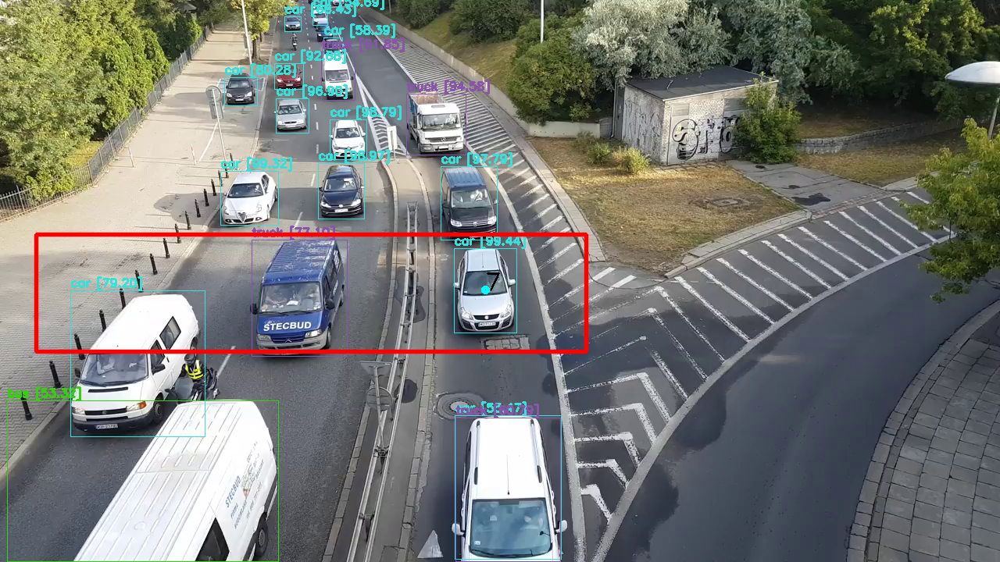

FPS: 2.778
{'car': 12}


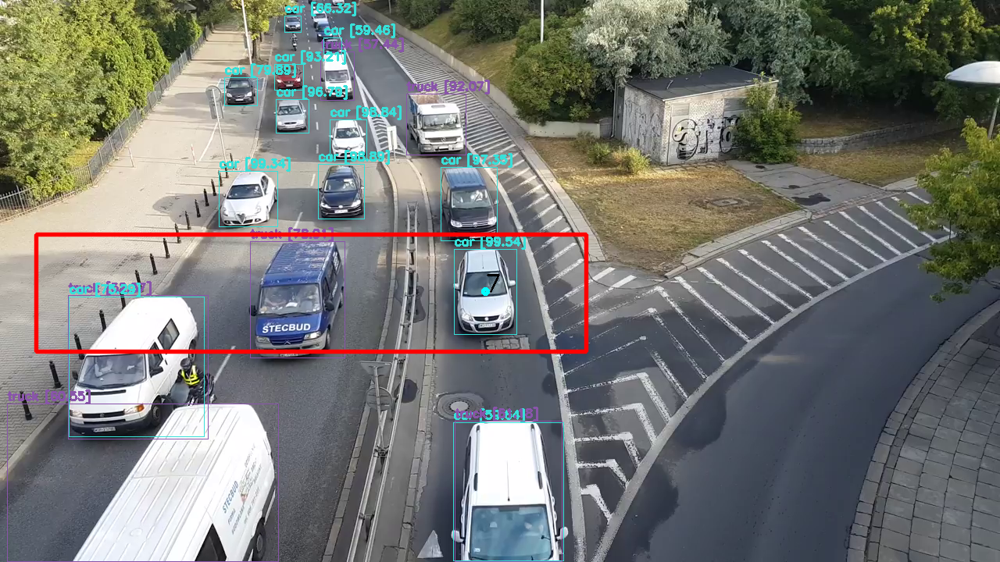

FPS: 2.193
{'car': 12}


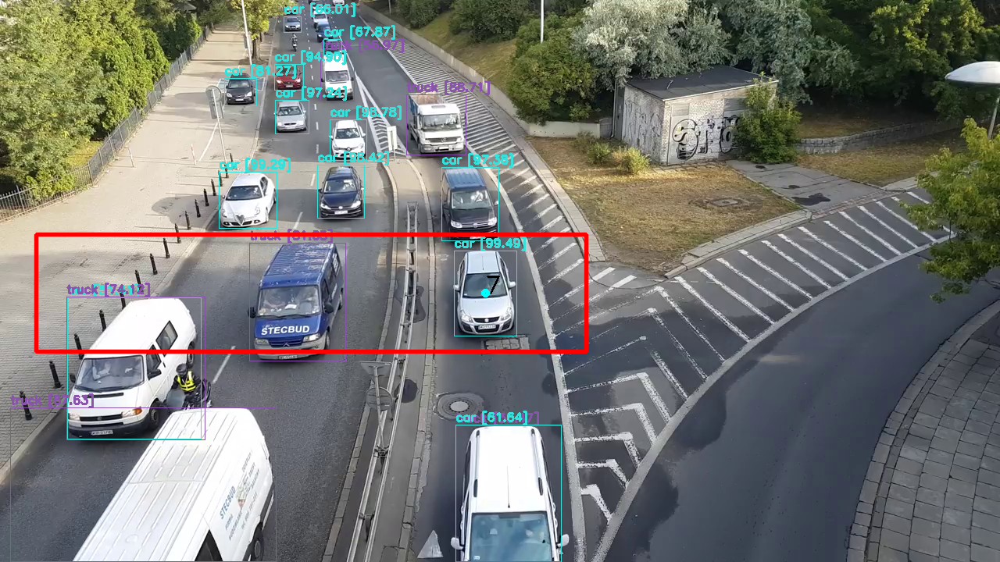

FPS: 2.232
{'car': 13}


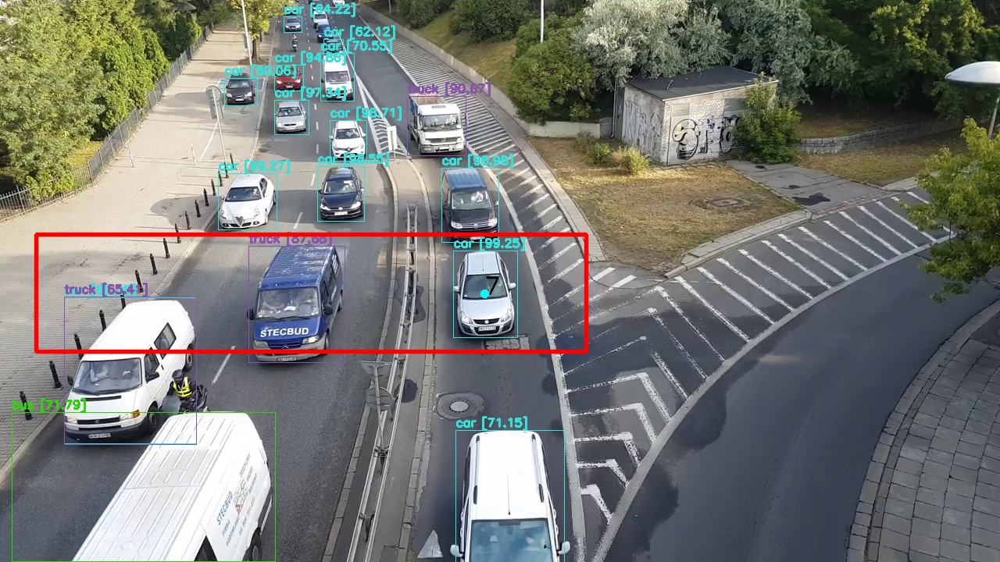

FPS: 2.094
{'car': 13}


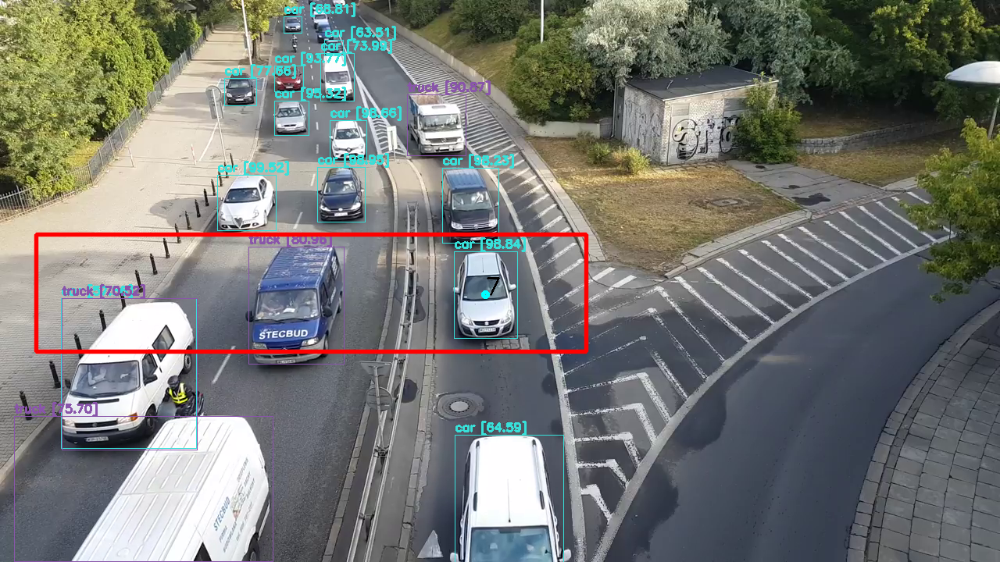

FPS: 1.979
{'car': 12}


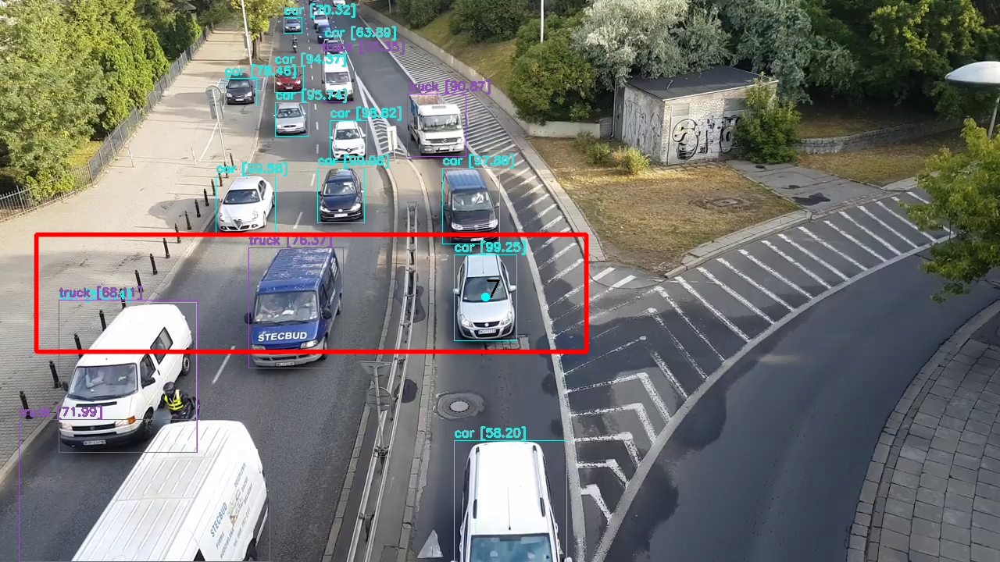

FPS: 2.123
{'car': 12}


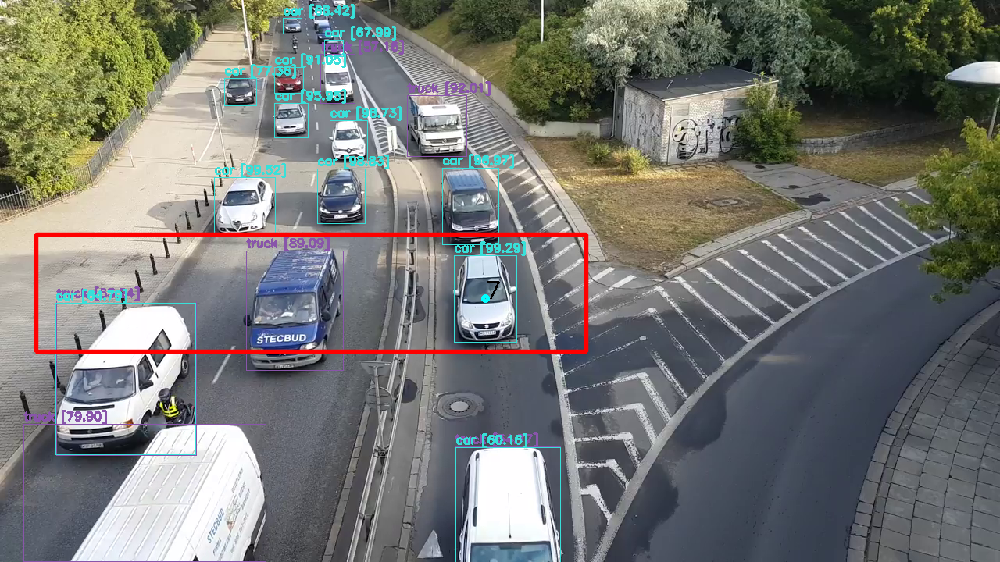

FPS: 1.872
{'car': 12}


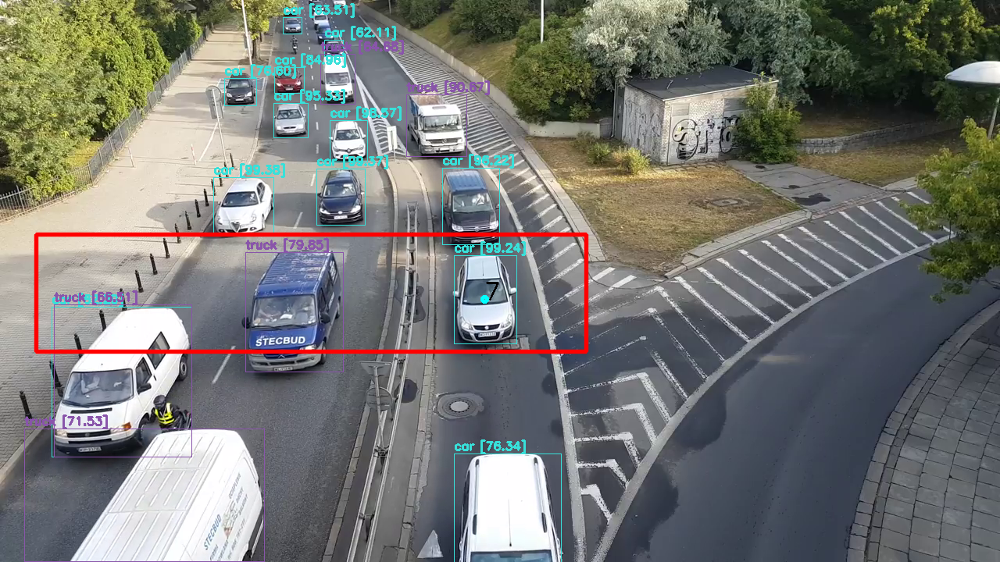

FPS: 2.068
{'car': 13}


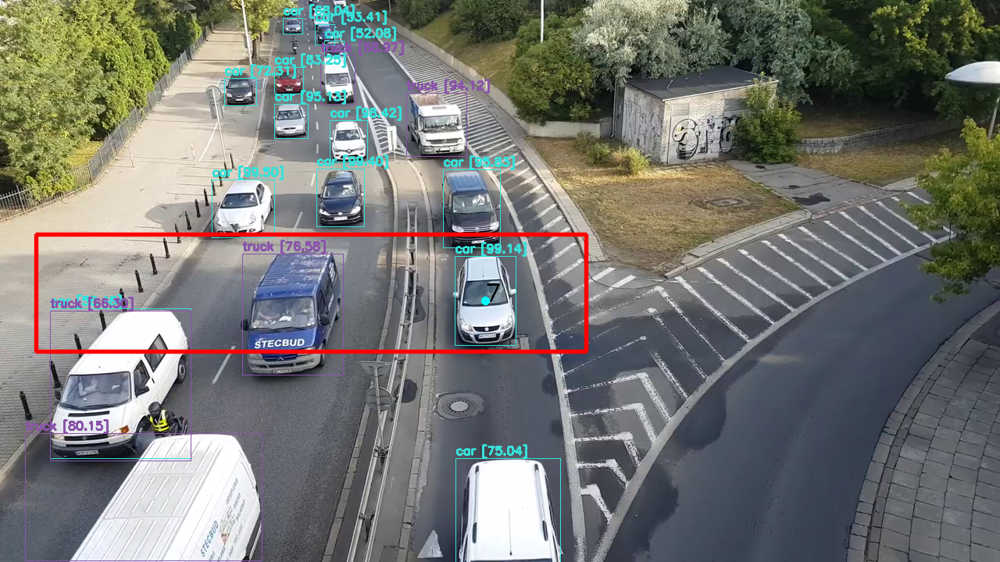

FPS: 1.957
{'car': 13}


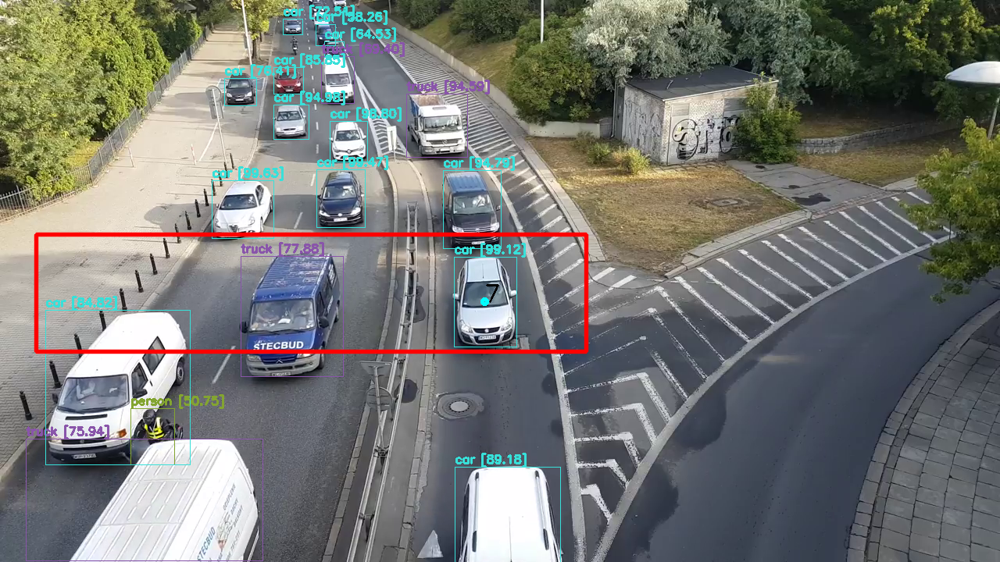

FPS: 2.05
{'car': 13}


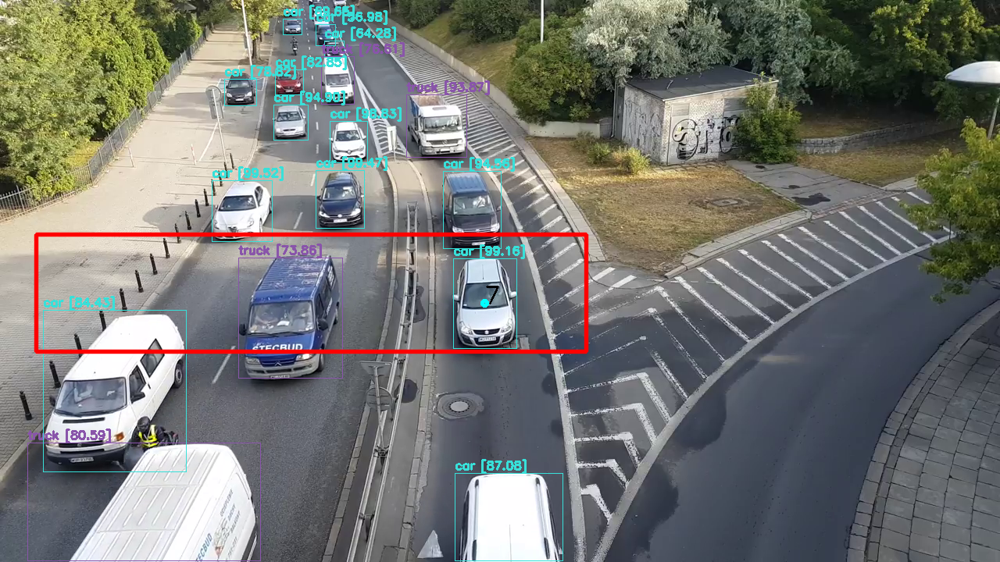

FPS: 1.839
{'car': 13}


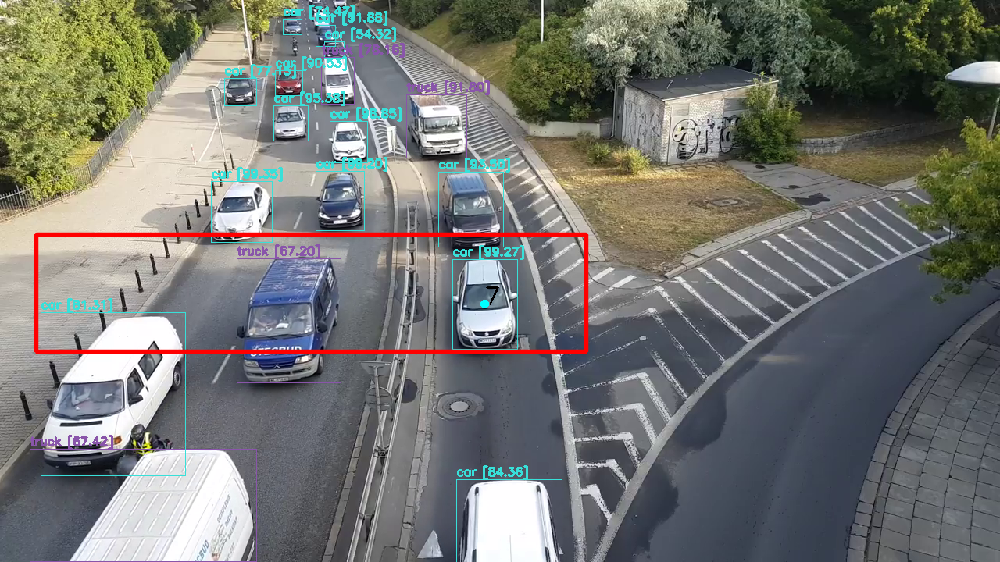

FPS: 1.909
{'car': 12}


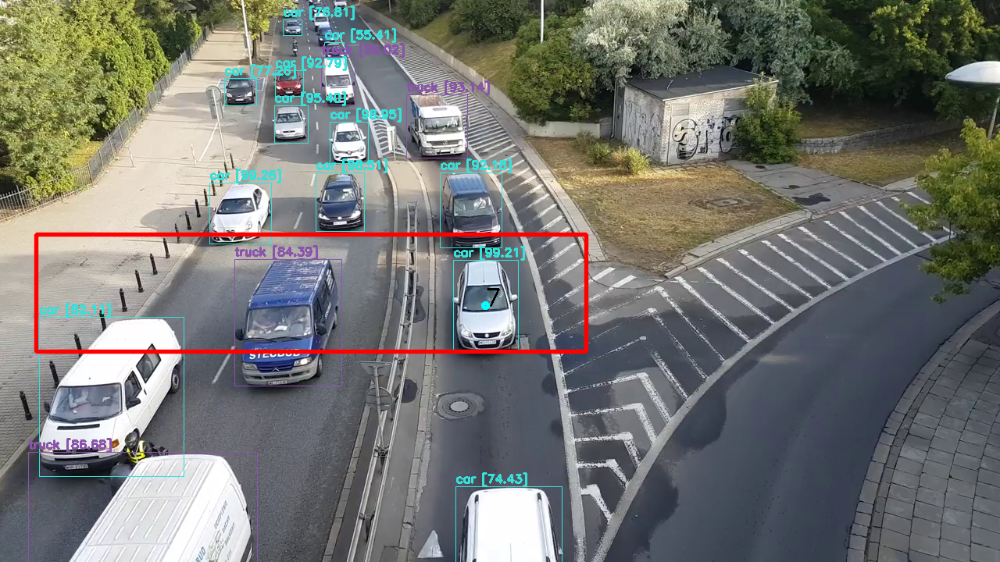

FPS: 1.913
{'car': 12}


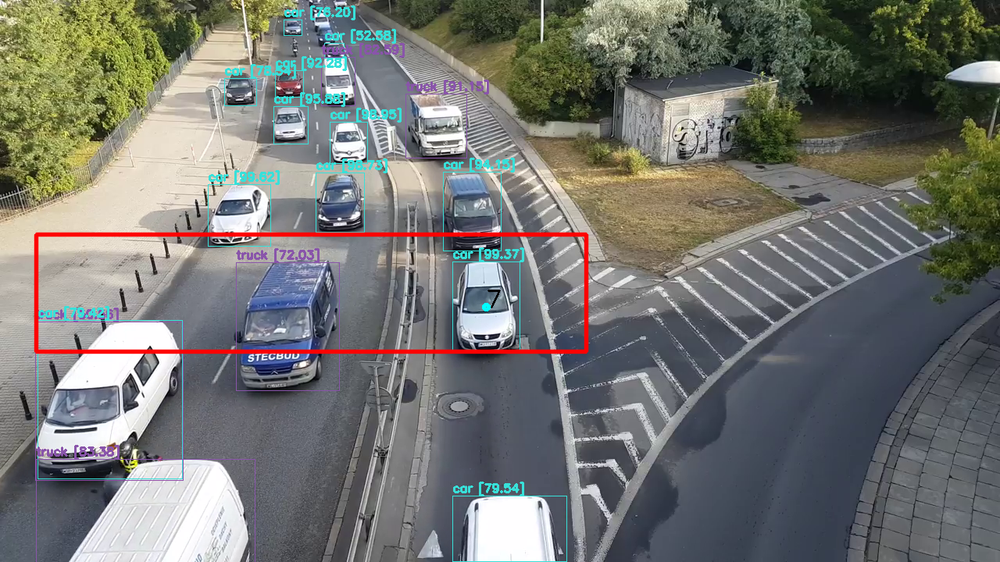

FPS: 2.006
{'car': 12}


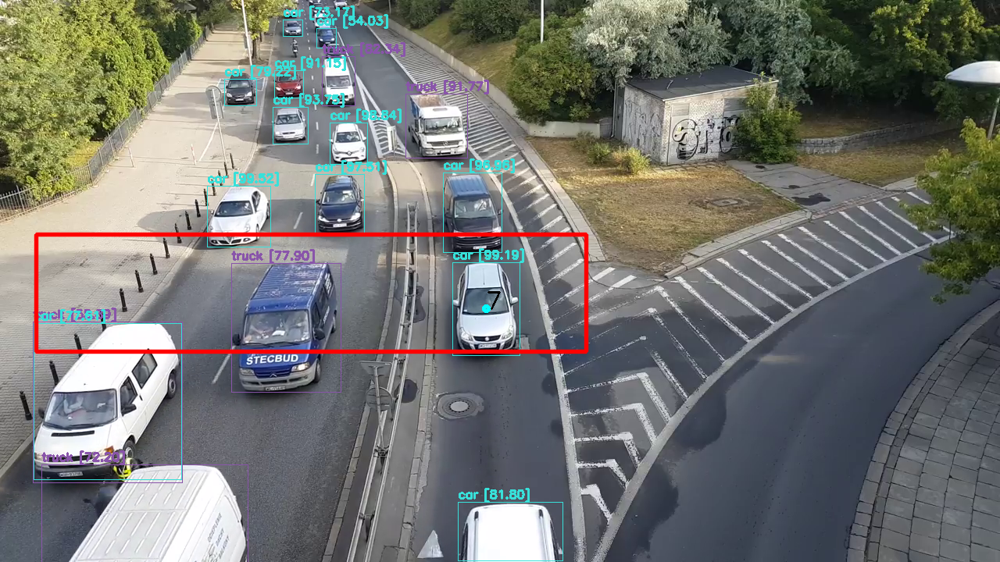

FPS: 2.082
{'car': 12}


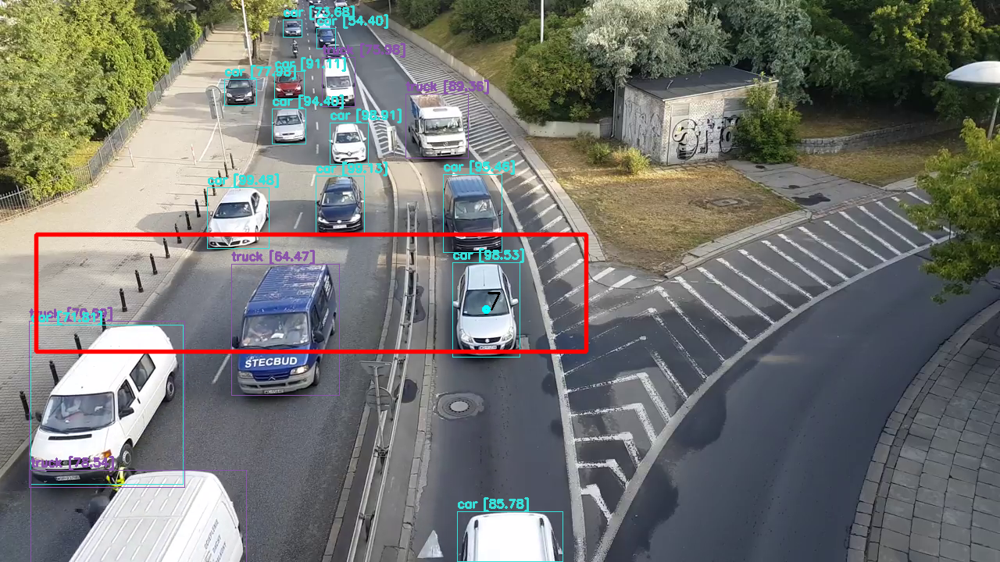

FPS: 2.098
{'car': 12}


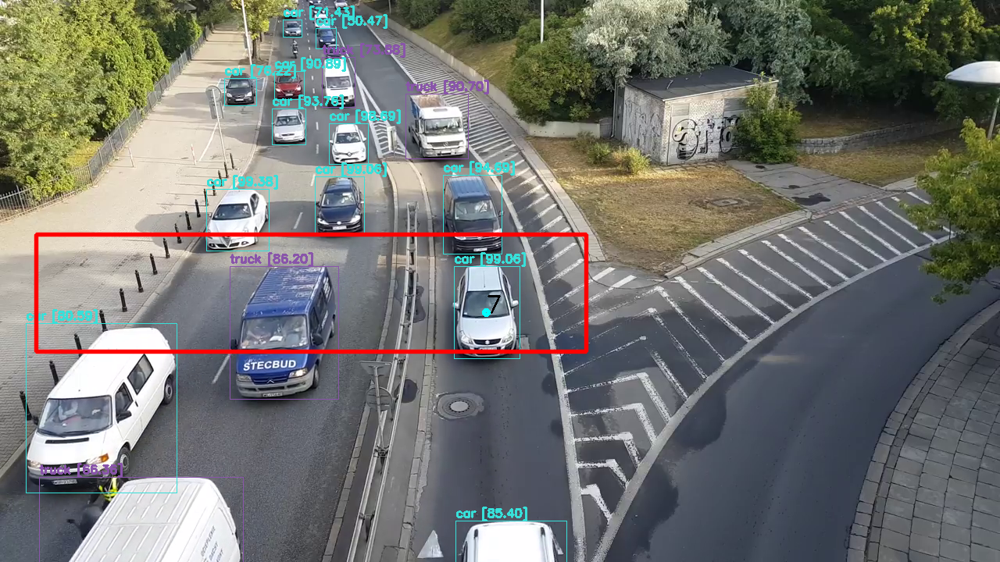

FPS: 1.99
{'car': 12}


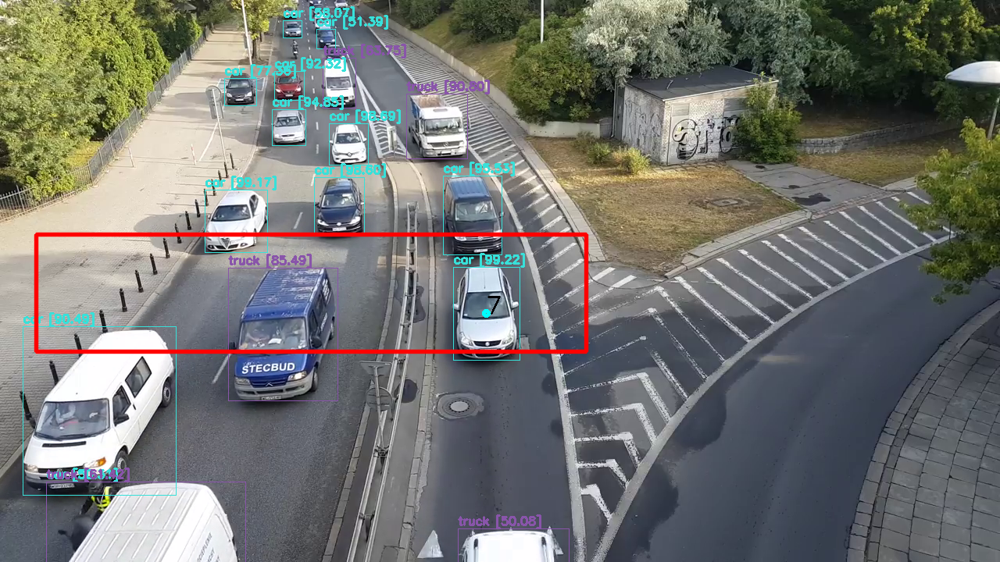

FPS: 2.092
{'car': 11}


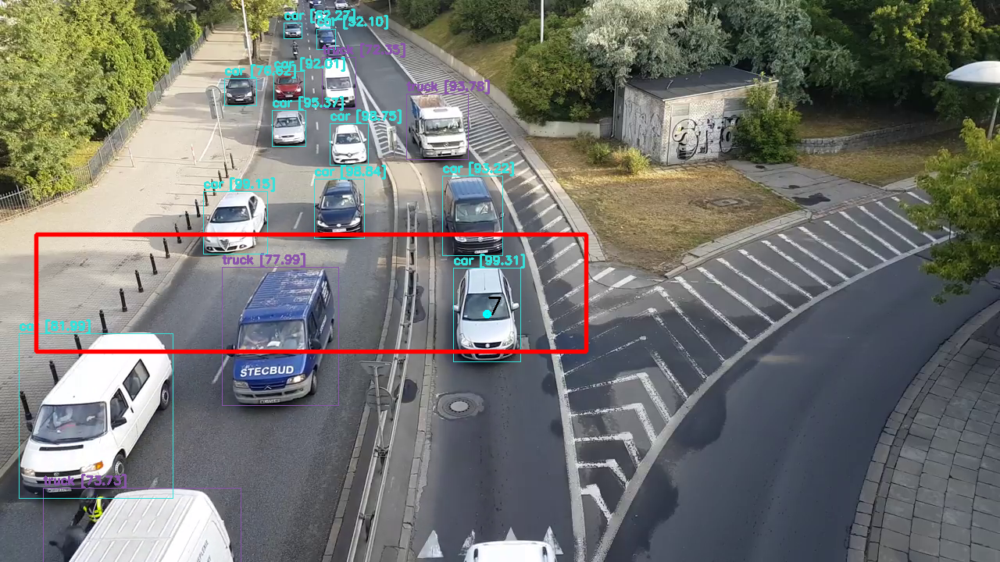

FPS: 2.048
{'car': 11}


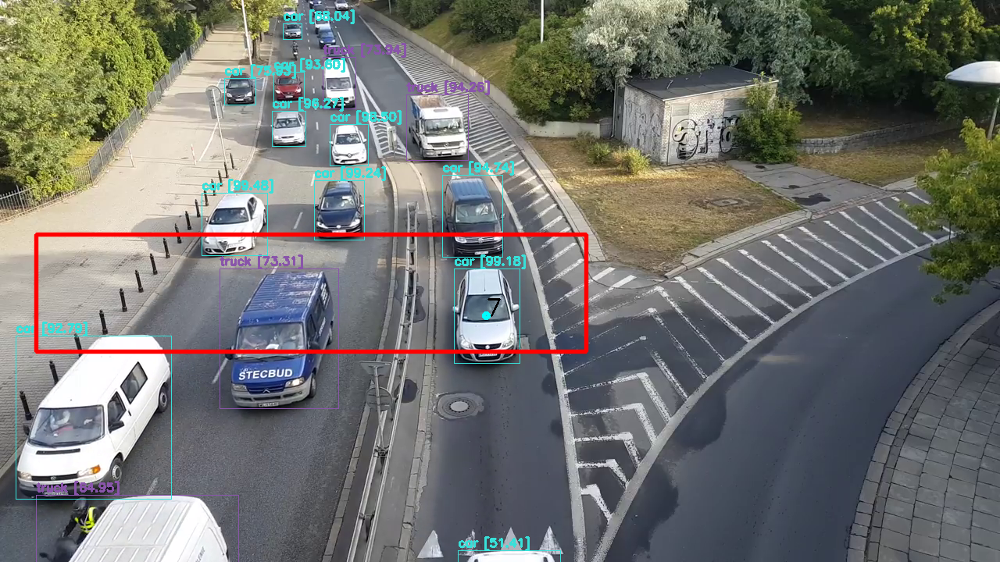

FPS: 2.012
{'car': 10}


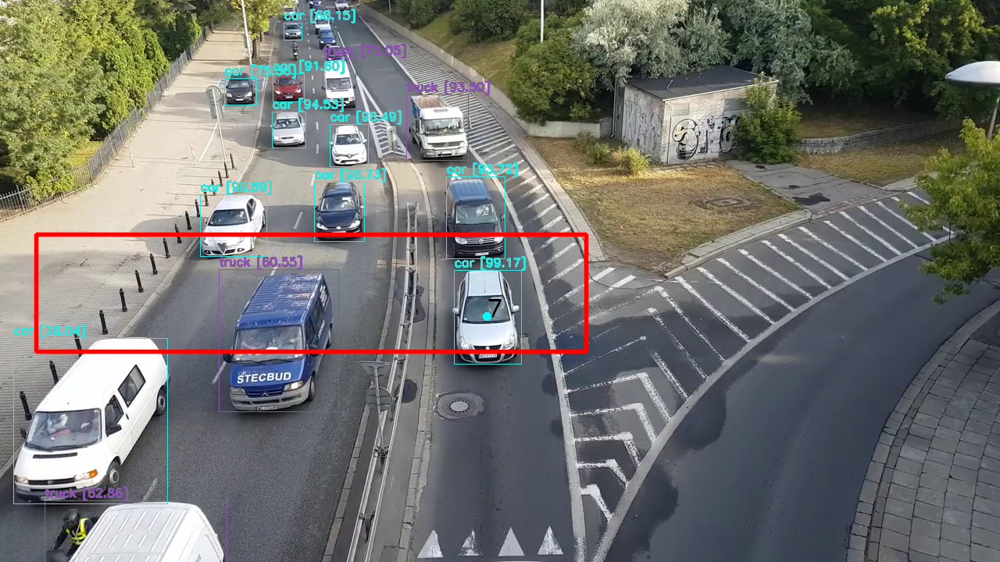

FPS: 2.011
{'car': 12}


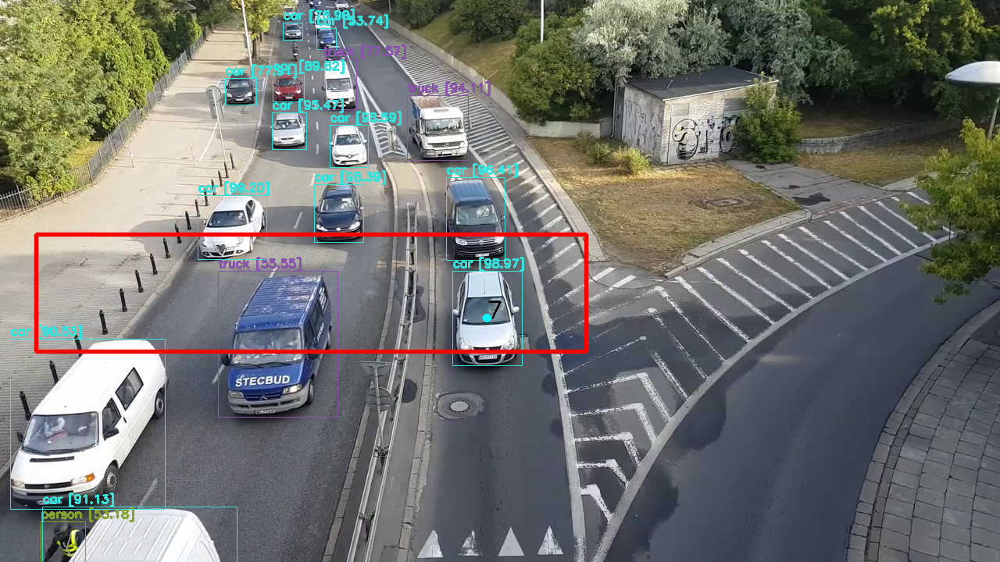

FPS: 1.792
{'car': 12}


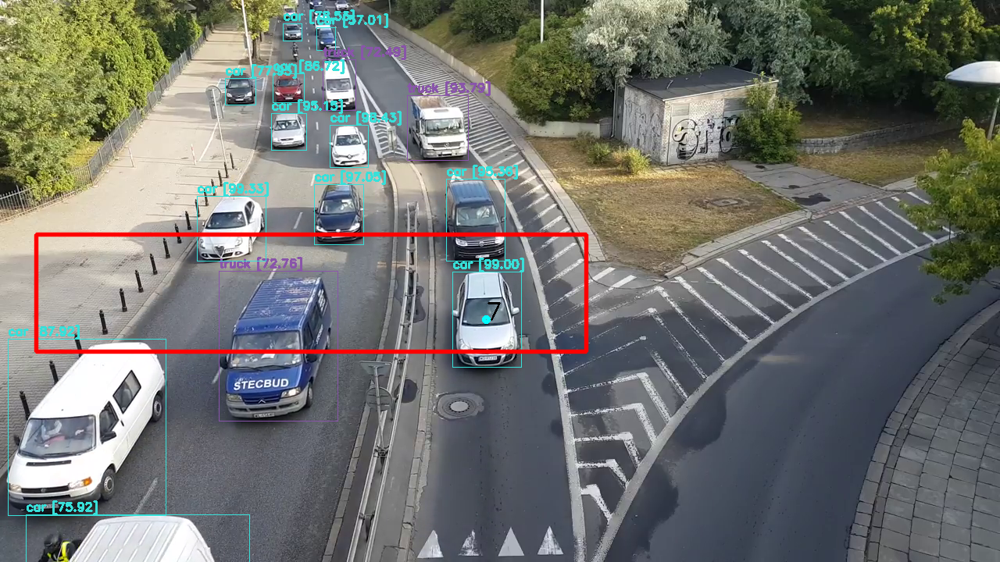

FPS: 2.021
{'car': 11}


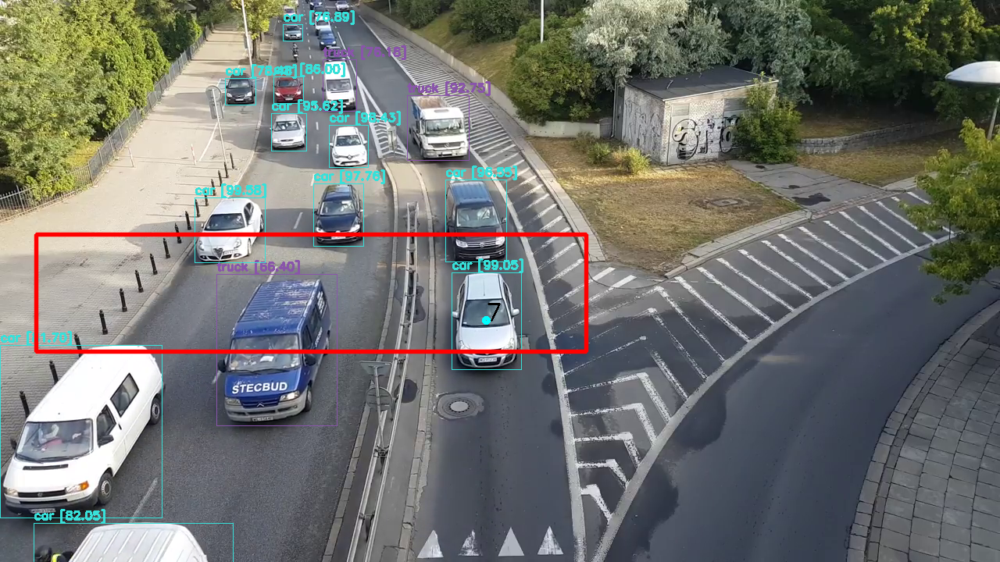

FPS: 2.04
{'car': 11}


In [ ]:
sum1=[]
cap = cv2.VideoCapture(TARGET)
ObjList=[]
while 1:
    try:
        ret, frame = cap.read() #ret=retval,frame=image        
        stime = time.time()
        #sector=frame[300:588,46:750]
       
        #                                   影像   神經網路   物件名稱      顏色         信任度
        frame, detections = image_detection(frame, network, class_names, class_colors, CONFTH)
        # detections=(物件名稱,信任度,x,y,w,h)
        # 計算車流量
        PredDict={'car':0 }#,'truck':0,'bus':0,'motorbike':0}

        #偵測區域
        cv2.rectangle(frame, (46, 300), (750, 450), (0,0,255), 3, cv2.LINE_AA)
        #新畫面中所有物件中心點        
        newCenterList=[]
        for i in range(len(detections)):            
            if detections[i][0] in PredDict.keys():
                PredDict[detections[i][0]] += 1
                #中心點
                (x,y)=(int(detections[i][2][0]),int(detections[i][2][1]))
                if x>46 and x<750 and y>300 and y<450:                    
                    newCenterList.append((x,y))
                    cv2.circle(frame,(x,y), 3, (255,255,0), 3)
        print(PredDict)
       
        #將新中心點與現有中心點比對
        ObjList,objIndex=TrackObj(newCenterList,ObjList,objIndex)
        for i in range(len(ObjList)):
            cv2.putText(frame, str(ObjList[i][0]), (ObjList[i][1], ObjList[i][2]), cv2.FONT_HERSHEY_SIMPLEX,1, (0, 0, 0), 2)

        cv2_imshow(frame)      
        # cv2.imshow('Inference', frame)
        # key =  cv2.waitKey(1)
        # if key == ord('q'):
        #     break
        etime = time.time()
        fps = round(1/(etime-stime),3)
        sum1.append(fps)
        print("FPS: {}".format(fps))
        # clear_output(wait=True) 
    except Exception as err:
        print(err)
        break

pass